In [1]:
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
import pandas as pd
pi=np.pi
cos=np.cos
sin=np.sin

In [2]:
def SF_carr(n,t):
    y=0
    for k in range(1,n+1,2):
        y+=(4/(k*pi))*sin(k*t)
    return y

In [3]:
def SF_triang(n,t):
    y=0
    for k in range(1,n+1,2):
        y+=(4/(k**2*pi))*cos(k*t)
    return y

In [4]:
def carr(t):
    if int(np.floor(t/pi))%2==0:
        return 1
    else:
        return -1

vcarr=np.vectorize(carr)

In [5]:
def triang(t):
    T=(t+pi)%(2*pi)-pi
    return (pi/2)-np.abs(T)

vtriang=np.vectorize(triang)

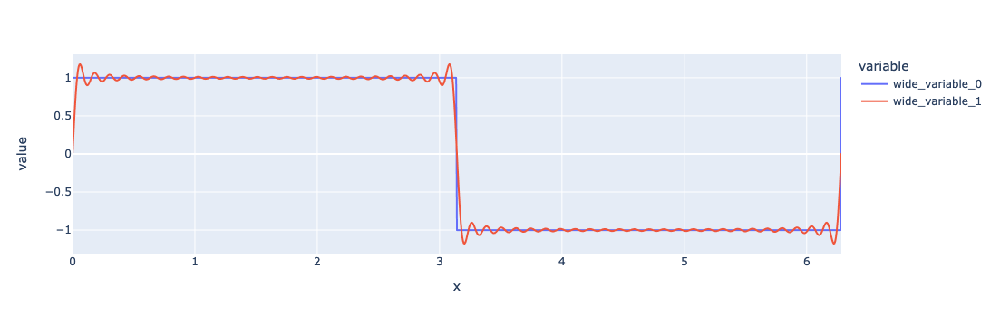

In [6]:
t=np.linspace(0,2*pi, 1001)
y1=vcarr(t)
y2=SF_carr(51,t)
fig=px.line(x=t,y=[y1,y2])
fig.show()

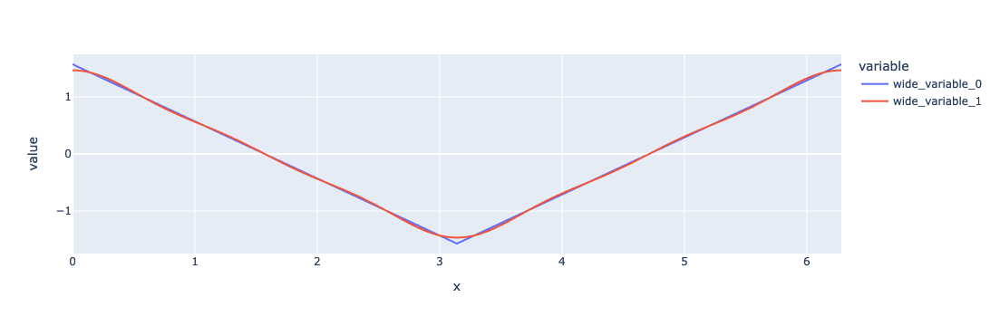

In [7]:
t=np.linspace(0,2*pi, 1001)
y1=vtriang(t)
y2=SF_triang(5,t)
fig=px.line(x=t,y=[y1,y2])
fig.show()

In [8]:
datacarr=[]
T=np.linspace(0,10*pi,5001)
for n in range(30):
    for t in T:
        datacarr.append({'t':t,'Amplitude':carr(t),'Signal':'signal carré','n':n})
        datacarr.append({'t':t,'Amplitude':SF_carr(n,t),'Signal':'synthèse de Fourier','n':n})

In [9]:
dfcarr=pd.DataFrame(datacarr)

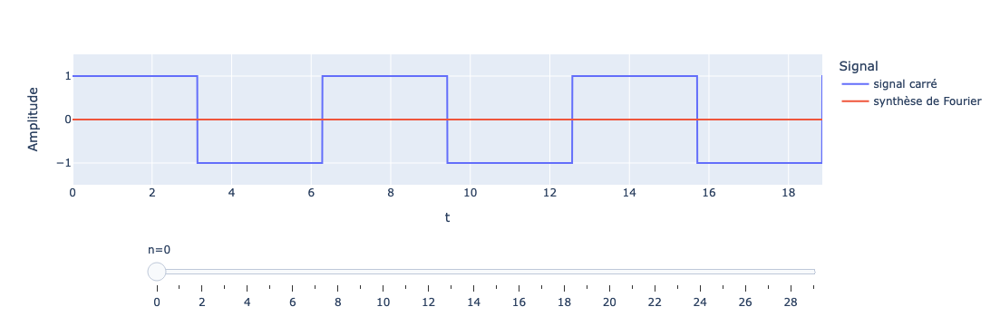

In [10]:
figcarr=px.line(dfcarr,x='t',y='Amplitude',animation_frame='n',range_x=[0,6*pi],range_y=[-1.5,1.5],color='Signal')
figcarr.update_layout(hovermode=False)
figcarr["layout"].pop("updatemenus")
figcarr.show()
figcarr.write_html("testcarr.html",auto_play=False)

In [11]:
datatriang=[]
T=np.linspace(0,10*pi,5001)
for n in range(10):
    for t in T:
        datatriang.append({'t':t,'Amplitude':triang(t),'Signal':'signal triangulaire','n':n})
        datatriang.append({'t':t,'Amplitude':SF_triang(n,t),'Signal':'synthèse de Fourier','n':n})

In [12]:
dftriang=pd.DataFrame(datatriang)

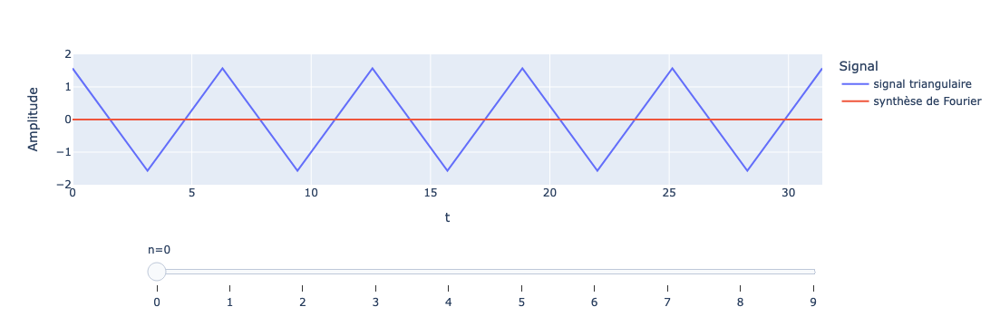

In [13]:
figtriang=px.line(dftriang,x='t',y='Amplitude',animation_frame='n',range_x=[0,10*pi],range_y=[-2,2],color='Signal')
figtriang.update_layout(hovermode=False)
figtriang["layout"].pop("updatemenus")
figtriang.show()
figtriang.write_html("testtriang.html",auto_play=False)